<a href="https://colab.research.google.com/github/federicocanzonieri/DeepLearning/blob/main/DeepLearningEsercizi_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pytorch_lightning
!pip install torchsummary

     |████████████████████████████████| 1.0 MB 5.2 MB/s 
     |████████████████████████████████| 132 kB 53.0 MB/s 
     |████████████████████████████████| 596 kB 29.4 MB/s 
     |████████████████████████████████| 829 kB 36.5 MB/s 
     |████████████████████████████████| 329 kB 32.3 MB/s 
     |████████████████████████████████| 1.1 MB 38.8 MB/s 
     |████████████████████████████████| 160 kB 45.8 MB/s 
     |████████████████████████████████| 271 kB 46 kB/s 
     |████████████████████████████████| 192 kB 49.0 MB/s 
  Created wheel for future: filename=future-0.18.2-py3-none-any.whl size=491070 sha256=9611d6e786d4e0ddf26b502cc3547a44ebe5500ea887787f9bc576f8a27059ec
  Stored in directory: /root/.cache/pip/wheels/56/b0/fe/4410d17b32f1f0c3cf54cdfb2bc04d7b4b8f4ae377e2229ba0
Successfully built future
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
  Attempting uninstall: future
    Found existi

In [ ]:
# IMPORT

import torch
import random
import numpy as np
import glob 
import random
import os
from torch.utils.data import Dataset
from PIL import Image
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
from matplotlib import pyplot as plt
import pytorch_lightning as pl
import itertools
from torch.utils.data import DataLoader
import torchvision
from pytorch_lightning.loggers import TensorBoardLogger


# Esercizio 1

Gli autori di CycleGAN mettono a disposizione diversi dataset sui quali sperimentare al
seguente link: https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/. Si copi e
adatti l'implementazione di CycleGAN qui definita per creare un programma contenuto in un file
cyclegan.py . Il programma deve prendere in input come argomenti i parametri dell'oggetto
CycleGAN, più il nome dell'esperimento di Tensorboard per il salvataggio dei log. Si usi il
programma appena creato per allenare CycleGAN su uno degli altri dataset proposti al link.


In [ ]:
!wget https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/cezanne2photo.zip
!unzip cezanne2photo.zip

In [ ]:
# !unzip cezanne2photo.zip

In [ ]:
# !ls cezanne2photo/trainB

In [ ]:
##cyclegan.py

class ImageDataset(Dataset):
  def __init__(self, root, transform=None, mode='train'):
    self.transform = transform #conserva la transform
    # ottieni i path delle immagini in A e B
    self.files_A = sorted(glob.glob(os.path.join(root, '%sA' % mode) + '/*.*'))
    self.files_B = sorted(glob.glob(os.path.join(root, '%sB' % mode) + '/*.*'))
  
  def __getitem__(self, index):
    #apro l'iesima immagine A (uso il modulo per evitare di sforare)
    item_A = Image.open(self.files_A[index % len(self.files_A)])
    #apro una immagine B a caso
    item_B = Image.open(self.files_B[random.randint(0, len(self.files_B) - 1)])
    
    if self.transform:
      item_A = self.transform(item_A)
      item_B = self.transform(item_B)
    return item_A, item_B

  def __len__(self):
    return max(len(self.files_A), len(self.files_B))

dataset=ImageDataset("cezanne2photo")

In [ ]:
print(type(dataset[0][0]))
print(type(dataset))
print(len(dataset))
print(dataset[0][0].size)

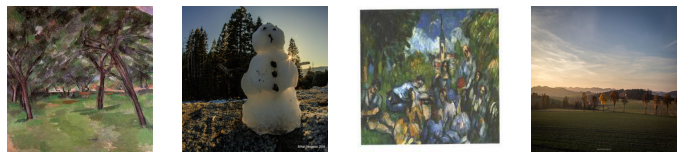

In [ ]:
plt.figure(figsize=(12,8))
plt.subplot(141)
plt.imshow(np.array(dataset[0][0]))
plt.axis('off')
plt.subplot(142)
plt.imshow(np.array(dataset[0][1]))
plt.axis('off')
plt.subplot(143)
plt.imshow(np.array(dataset[1][0]))
plt.axis('off')
plt.subplot(144)
plt.imshow(np.array(dataset[1][1]))
plt.axis('off')
plt.show()

In [ ]:
class ResidualBlock(nn.Module):
  def __init__(self,in_features):
    super(ResidualBlock,self).__init__()
    conv_block= [ nn.ReflectionPad2d(1),
                  nn.Conv2d(in_features,in_features,3),
                  nn.InstanceNorm2d(in_features),
                  nn.ReLU(inplace=True),
                  nn.ReflectionPad2d(1),
                  nn.Conv2d(in_features,in_features,3),
                  nn.InstanceNorm2d(in_features)]

    self.conv_block=nn.Sequential(*conv_block)

  def forward(self,x):
    return x + self.conv_block(x)

In [ ]:
class Generator(nn.Module):
  def __init__(self,input_nc,output_nc,n_res_block=9):
    super(Generator,self).__init__()
    
    model = [nn.ReflectionPad2d(3),
             nn.Conv2d(input_nc,64,7),
             nn.InstanceNorm2d(64),
             nn.ReLU(inplace=True)]
    
    in_features=64
    out_features=in_features*2

    for _ in range(2):
      model+=[ nn.Conv2d(in_features,out_features,3,stride=2,padding=1),
               nn.InstanceNorm2d(out_features),
               nn.ReLU(inplace=True)]
      in_features=out_features
      out_features=in_features*2

    for _ in range(n_res_block):
      model+=[ResidualBlock(in_features)]

    out_features=in_features//2
    for _ in range(2):
      model+=[nn.ConvTranspose2d(in_features,out_features,3,stride=2,padding=1,output_padding=1),
              nn.InstanceNorm2d(out_features),
              nn.ReLU(inplace=True)]
      in_features=out_features
      out_features=in_features//2
    
    model+=[nn.ReflectionPad2d(3),
            nn.Conv2d(64,output_nc,7),
            nn.Tanh()]
    self.model=nn.Sequential(*model)

  def forward(self,x):
    return self.model(x)

In [ ]:
gen=Generator(3,3).cuda()
summary(gen,(3,224,224))

In [ ]:
class Discriminator(nn.Module):
  def __init__(self,input_nc):
    super(Discriminator,self).__init__()

    model=[nn.Conv2d(input_nc,64,4,stride=2,padding=1),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(64,128,4,stride=2,padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(128,256,4,stride=2,padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2,inplace=True)]
    model+=[nn.Conv2d(256,512,4,padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2,inplace=True)]
    
    model+=[nn.Conv2d(512,1,4,padding=1)]
    self.model=nn.Sequential(*model)

  def forward(self,x):
    x=self.model(x)
    return F.avg_pool2d(x,x.size()[2:]).view(x.size()[0],-1)


In [ ]:
class LambdaLR():
  def __init__(self,n_epochs,offset,decay_start_epoch):
    assert ((n_epochs-decay_start_epoch)>0),"Decay must start before the training sess"
    self.n_epochs=n_epochs
    self.offset=offset
    self.decay_start_epoch=decay_start_epoch

  def step(self,epoch):
    return 1.0 - max(0,epoch+self.offset-self.decay_start_epoch)/(self.n_epochs-self.decay_start_epoch)

def weights_init_normal(m):
  classname = m.__class__.__name__
  # Inizializziamo le convoluzioni con rumore gaussiano
  # di media zero e deviazione standard 0.02
  if classname.find('Conv') != -1:
    m.weight.data.normal_(0.0, 0.02)
  # Nel caso della batchnorm2d useremo media 1 e deviazione standard 0.02
  elif classname.find('BatchNorm2d') != -1:
    m.weight.data.normal_(1.0, 0.02)
    # il bias è costante e pari a zero
    m.bias.data.fill_(0.0)
      

In [ ]:
class CycleGAN(pl.LightningModule):
  def __init__(self, 
      input_nc = 3, # numero di canali in input
      output_nc = 3, # numero di canali in output
      image_size = 128, # la dimensione dell'immagine
      lr=0.002, # learning rate
      betas=(0.5, 0.999), # valori beta di Adam
      starting_epoch=0, # epoca di partenza (0 se non stiamo facendo resume di un training interrotto)
      n_epochs=200, # numero totale di epoche
      decay_epoch=100, # epoca dopo la quale iniziare a far scendere il learning rate
      batch_size = 1, #batch size (MUST BE 1)
      n_cpu = 8, # numeri di thread per il dataloader
      data_root=None, #cartella in cui si trovano i dati
    ):
    super(CycleGAN, self).__init__()
    self.save_hyperparameters()
    
    # Definiamo due generatori: da A a B e da B ad A
    self.netG_A2B = Generator(input_nc, output_nc)
    self.netG_B2A = Generator(output_nc, input_nc)
    
    # Definiamo due discriminatori: uno per A e uno per B
    self.netD_A = Discriminator(input_nc)
    self.netD_B = Discriminator(output_nc)
    
    # Applichiamo la normalizzazione
    self.netG_A2B.apply(weights_init_normal)
    self.netG_B2A.apply(weights_init_normal)
    self.netD_A.apply(weights_init_normal)
    self.netD_B.apply(weights_init_normal)
    
    # Definiamo le loss
    self.criterion_GAN = torch.nn.MSELoss()
    self.criterion_cycle = torch.nn.L1Loss()
    self.criterion_identity = torch.nn.L1Loss()
    

  def forward(self, x, mode='A2B'):
    if mode=='A2B':
      return netG_A2B(x)
    else:
      return netG_B2A(x)
    
  # ci servono 3 optimizer, ognuno con il suo scheduler
  def configure_optimizers(self):
    # Optimizer per il generatore
    optimizer_G = torch.optim.Adam(itertools.chain(self.netG_A2B.parameters(), self.netG_B2A.parameters()),lr=self.hparams.lr, betas=self.hparams.betas)
    
    # Optimizers per i due discriminatori
    optimizer_D_A = torch.optim.Adam(self.netD_A.parameters(), lr=self.hparams.lr,    betas=self.hparams.betas)
    optimizer_D_B = torch.optim.Adam(self.netD_B.parameters(), lr=self.hparams.lr,    betas=self.hparams.betas)
    
    lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
    lr_scheduler_D_A = torch.optim.lr_scheduler.LambdaLR(optimizer_D_A, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
    lr_scheduler_D_B = torch.optim.lr_scheduler.LambdaLR(optimizer_D_B, lr_lambda=LambdaLR(self.hparams.n_epochs, self.hparams.starting_epoch, self.hparams.decay_epoch).step)
  
    # Restituiamo i tre optimizer e i tre optimizers
    return [optimizer_G, optimizer_D_A, optimizer_D_B], [lr_scheduler_G, lr_scheduler_D_A, lr_scheduler_D_B]

  def training_step(self, batch, batch_idx, optimizer_idx):
    real_A, real_B = batch
    # print(real_A,real_B)
    # print(real_A.shape,real_B.shape)
    

    target_real = torch.ones((real_A.shape[0],1)).type_as(real_A)
    target_fake = torch.zeros((real_A.shape[0],1)).type_as(real_A)
    
    # optimizer del generatore
    if optimizer_idx==0:
      # Identity loss
      # G_A2B(B) should equal B if real B is fed
      same_B = self.netG_A2B(real_B) # passa B al generatore A2B - deve essere uguale a B
      loss_identity_B = self.criterion_identity(same_B, real_B)*5.0
      # G_B2A(A) should equal A if real A is fed
      same_A = self.netG_B2A(real_A) # passa A al generatore B2A - deve essere uguale ad A
      loss_identity_A = self.criterion_identity(same_A, real_A)*5.0
      # GAN loss
      fake_B = self.netG_A2B(real_A) # passa A ad A2B - sono le fake B
      pred_fake = self.netD_B(fake_B) # predizioni del discriminatore B
      loss_GAN_A2B = self.criterion_GAN(pred_fake, target_real) # loss GAN per A2B

      fake_A = self.netG_B2A(real_B) # passa B a B2A - sono le fake A
      pred_fake = self.netD_A(fake_A) # predizioni del discriminatore A
      loss_GAN_B2A = self.criterion_GAN(pred_fake, target_real) # loss GAN per B2A
      # Cycle consistency loss
      recovered_A = self.netG_B2A(fake_B) #passiamo le fake B a B2A - devono essere uguali a real_A
      loss_cycle_ABA = self.criterion_cycle(recovered_A, real_A)*10.0 #cycle consistency loss
      recovered_B = self.netG_A2B(fake_A) #passiamo le fake A a A2B - devono essere uguali a real_B
      loss_cycle_BAB = self.criterion_cycle(recovered_B, real_B)*10.0 #cycle consistency loss
      # loss globale
      loss_G = loss_identity_A + loss_identity_B + loss_GAN_A2B + loss_GAN_B2A + loss_cycle_ABA + loss_cycle_BAB
      self.log('loss_G/loss_identity_A', loss_identity_A)
      self.log('loss_G/loss_identity_B', loss_identity_B)
      self.log('loss_G/loss_GAN_A2B', loss_GAN_A2B)
      self.log('loss_G/loss_GAN_B2A', loss_GAN_B2A)
      self.log('loss_G/loss_cycle_ABA', loss_cycle_ABA)
      self.log('loss_G/loss_cycle_BAB', loss_cycle_BAB)
      self.log('loss_G/overall', loss_G)
      
    # loggiamo dei campioni visivi da ispezionare durante il training ogni 100 batch
      if batch_idx % 100 ==0:
        grid_A = torchvision.utils.make_grid(real_A[:50], nrow=10, normalize=True)
        grid_A2B = torchvision.utils.make_grid(fake_B[:50], nrow=10, normalize=True)
        grid_A2B2A = torchvision.utils.make_grid(recovered_A[:50], nrow=10, normalize=True)
        
        grid_B = torchvision.utils.make_grid(real_B[:50], nrow=10, normalize=True)
        grid_B2A = torchvision.utils.make_grid(fake_A[:50], nrow=10, normalize=True)
        grid_B2A2B = torchvision.utils.make_grid(recovered_B[:50], nrow=10, normalize=True)
        
        self.logger.experiment.add_image('A/A', grid_A, self.global_step)
        self.logger.experiment.add_image('A/A2B', grid_A2B, self.global_step)
        self.logger.experiment.add_image('A/A2B2A', grid_A2B2A, self.global_step)
        
        self.logger.experiment.add_image('B/B', grid_B, self.global_step)
        self.logger.experiment.add_image('B/B2A', grid_B2A, self.global_step)
        self.logger.experiment.add_image('B/B2A2B', grid_B2A2B, self.global_step)
        
        return loss_G
    
    elif optimizer_idx==1: #discriminatore A
      # Real loss
      pred_real = self.netD_A(real_A)
      loss_D_real = self.criterion_GAN(pred_real, target_real)
      # Fake loss
      fake_A = self.netG_B2A(real_B) # passa B a B2A - sono le fake A
      pred_fake = self.netD_A(fake_A.detach())
      loss_D_fake = self.criterion_GAN(pred_fake, target_fake)
      # loss globale
      loss_D_A = (loss_D_real + loss_D_fake)*0.5
      self.log('loss_D/loss_D_A',loss_D_A)
      return loss_D_A
    
    elif optimizer_idx==2: #discriminatore B
      pred_real = self.netD_B(real_B)
      loss_D_real = self.criterion_GAN(pred_real, target_real)
      # Fake loss
      fake_B = self.netG_A2B(real_A) # passa A ad A2B - sono le fake B
      pred_fake = self.netD_B(fake_B.detach())
      loss_D_fake = self.criterion_GAN(pred_fake, target_fake)
      # loss globale
      loss_D_B = (loss_D_real + loss_D_fake)*0.5
      self.log('loss_D/loss_D_B', loss_D_B)
      return loss_D_B

  def train_dataloader(self):
      transform = transforms.Compose([
        # transforms.Resize(int(self.hparams.image_size*2), Image.BICUBIC), #ridimensioniamo a una dimensione più grande di quella di input
        transforms.Resize((128,128), Image.BICUBIC), #ridimensioniamo a una dimensione più grande di quella di input
        transforms.RandomCrop(self.hparams.image_size), #random crop alla dimensione di input
        transforms.RandomHorizontalFlip(), #random flip orizzontale
        transforms.ToTensor(), #trasformiamo in tensore
        transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)) #applichiamo la normalizzazione
      ])
      
      dataloader = DataLoader(ImageDataset(self.hparams.data_root, transform=transform), 
      batch_size=self.hparams.batch_size, shuffle=True, num_workers=self.hparams.n_cpu)
      return dataloader

In [ ]:
%load_ext tensorboard 
%tensorboard --logdir tb_logs

<IPython.core.display.Javascript object>

In [ ]:
root_dir="cezanne2photo"

In [ ]:
!wget https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/{root_dir}.zip
!unzip {root_dir}.zip

In [ ]:
# root_dir="cezanne2photo"
cycle_gan = CycleGAN(data_root=root_dir)
logger = TensorBoardLogger("tb_logs", name=root_dir+"_cyclegan")
trainer = pl.Trainer(gpus=1, logger=logger, max_epochs=20)
trainer.fit(cycle_gan)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name               | Type          | Params
-----------------------------------------------------
0 | netG_A2B           | Generator     | 11.4 M
1 | netG_B2A           | Generator     | 11.4 M
2 | netD_A             | Discriminator | 2.8 M 
3 | netD_B             | Discriminator | 2.8 M 
4 | criterion_GAN      | MSELoss       | 0     
5 | criterion_cycle    | L1Loss        | 0     
6 | criterion_identity | L1Loss        | 0     
-----------------------------------------------------
28.3 M    Trainable params
0         Non-trainable params
28.3 M    Total params
113.143   Total estimated model params size (MB)
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpola

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/pytorch_lightning/loops/optimization/optimizer_loop.py:146: UserWarning: `training_step` returned `None`. If this was on purpose, ignore this warning...
  "`training_step` returned `None`. If this was on purpose, ignore this warning..."
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/trainer.py:685: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [ ]:
torch.save(cycle_gan,"cycle-gan")

# Esercizio 2

Si ripeta il training effettuato nell'esercizio precedente utilizzando l'implementazione ufficiale di
CycleGAN (https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix). Si confrontino i risultati
ottenuti con le due implementazioni.

In [ ]:
!git clone https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix
!pip install -r pytorch-CycleGAN-and-pix2pix/requirements.txt

In [ ]:
%cd pytorch-CycleGAN-and-pix2pix

In [ ]:
!bash ./datasets/download_cyclegan_dataset.sh  cezanne2photo

In [ ]:
!ls datasets

In [ ]:
!bash ./scripts/download_cyclegan_model.sh style_cezanne

In [ ]:
from google.colab.output import eval_js
print(eval_js("google.colab.kernel.proxyPort(8097)"))

In [ ]:
!python train.py --dataroot ./datasets/cezanne2photo --name cezanne2photo --model cycle_gan --use_wandb

In [ ]:
!bash ./scripts/download_cyclegan_model.sh horse2zebra
!bash ./datasets/download_cyclegan_dataset.sh horse2zebra
!python test.py --dataroot datasets/horse2zebra/testA --name horse2zebra_pretrained --model test --no_dropout --results_dir /content/prova

In [ ]:
!ls prova/horse2zebra_pretrained/test_latest/images

In [ ]:
!python -m 

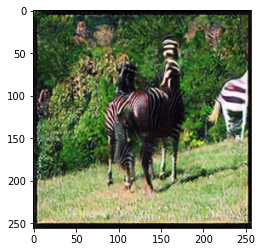

In [ ]:
import matplotlib.pyplot as plt

img = plt.imread('prova/horse2zebra_pretrained/test_latest/images/n02381460_1000_fake.png')
plt.imshow(img)

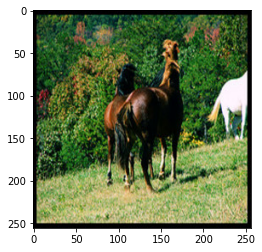

In [ ]:
import matplotlib.pyplot as plt

img = plt.imread('prova/horse2zebra_pretrained/test_latest/images/n02381460_1000_real.png')
plt.imshow(img)

In [ ]:
!bash ./datasets/download_cyclegan_dataset.sh cezanne2photo
#!./scripts/train_cyclegan.sh


In [ ]:
from google.colab.output import eval_js
print(eval_js("google.colab.kernel.proxyPort(8097)"))

https://b3fokcisujs-496ff2e9c6d22116-8097-colab.googleusercontent.com/


In [ ]:
!python -m visdom.server & 
!python train.py --dataroot ./datasets/cezanne2photo --name cezanne2photo --model cycle_gan


Traceback (most recent call last):
  File "train.py", line 52, in <module>
    model.optimize_parameters()   # calculate loss functions, get gradients, update network weights
  File "/content/pytorch-CycleGAN-and-pix2pix/models/cycle_gan_model.py", line 187, in optimize_parameters
    self.backward_G()             # calculate gradients for G_A and G_B
  File "/content/pytorch-CycleGAN-and-pix2pix/models/cycle_gan_model.py", line 178, in backward_G
    self.loss_G.backward()
  File "/usr/local/lib/python3.7/dist-packages/torch/_tensor.py", line 307, in backward
    torch.autograd.backward(self, gradient, retain_graph, create_graph, inputs=inputs)
  File "/usr/local/lib/python3.7/dist-packages/torch/autograd/__init__.py", line 156, in backward
    allow_unreachable=True, accumulate_grad=True)  # allow_unreachable flag
KeyboardInterrupt
